In [21]:
import pandas as pd
import pickle
import os 
pd.options.mode.chained_assignment = None
import datetime
import numpy as np
import os
import zipfile
import modules.ml_pipeline.readdata as mlpp
import sys

# Read and manipulate the dataset

In [22]:
# Load the raw data to disk
input_path = "data/converted.csv"
df = pd.read_csv(input_path)

# Convert all column names to lower case and display the dataframe 
df = df.rename(str.lower, axis='columns')

In [23]:
# Do some manipulations on the data and clean it (remove rows of all NaNs, remove duplicates, etc.)

# Remove any rows that have buoy velocity/mag =0 
df = df[df["buoy_vel_mag"] != 0]

# Remove any rows that have very low ice_thickness  
"""
sea ice concentration of 0.5 means that the surroundings of the buoy is 50% sea ice and 50% open water. So ice concentration of 
1 is full ice cover, while a concentration of 0.1 means there’S barely any ice left at that location!
"""
df = df[df["ice_thickness"] > 0.1]

# Print the dataframe dimensions
print("Dataframe final shape: ", df.shape)
display(df)

Dataframe final shape:  (327042, 21)


,index,year,month,day,doy,x_ease,y_ease,u_buoy,v_buoy,id_buoy,...,v_era5,sic_cdr,d2c,ice_thickness,buoy_lat,buoy_lon,buoy_vel_mag,buoy_vel_dir,wind_vel_mag,wind_vel_dir
0,0,1979,2,18,49,147.506958,138.582672,-0.797554,1.114740,1906,...,-0.321260,0.990195,522.523298,3.189743,78.007070,-128.549129,1.370671,2.191824,6.711849,3.189490
1,1,1979,2,18,49,146.834778,120.509880,0.643200,0.368754,1913,...,-0.674205,0.966372,412.767669,2.484009,74.498024,-119.750294,0.741408,0.520564,6.851881,3.240164
2,2,1979,2,18,49,130.993561,129.623672,-1.162420,0.243717,1914,...,1.123955,0.996022,362.547379,2.474106,74.003619,-134.786524,1.187695,2.934923,8.896751,3.014921
3,3,1979,2,18,49,147.524719,157.382492,0.919766,0.025784,1918,...,-1.035410,0.982681,381.025629,3.740522,81.019593,-145.578020,0.920127,0.028026,1.496117,3.905953
4,4,1979,2,19,50,147.470963,138.599823,0.380940,1.243485,1906,...,2.537787,0.990302,521.535334,3.188522,78.002077,-128.560665,1.300527,1.273525,3.338513,2.278041
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
329883,339472,2019,12,30,364,173.589722,117.012932,-13.455300,-10.662800,25560,...,-4.199740,1.000000,470.197315,0.933125,75.686986,-96.341501,17.168005,3.811734,8.234026,3.676847
329884,339473,2019,12,30,364,193.232056,172.742004,-0.981225,-11.698400,44880,...,-6.012877,1.000000,702.312813,1.517084,86.513431,-29.153877,11.739478,4.628723,6.522125,4.314615
329885,339474,2019,12,30,364,208.421234,142.049896,-7.247925,-5.289890,53005,...,-0.381765,1.000000,360.491321,1.164462,79.286760,-53.579091,8.973035,3.772087,4.630856,3.224141
329886,339475,2019,12,30,364,145.264023,146.109741,-0.913761,2.182150,95020,...,1.119087,1.000000,393.799208,2.010032,79.025667,-135.924079,2.365742,1.967356,2.240471,0.523007


# Train/Test split and normalization

In [24]:
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
df = df[['ice_thickness', 'wind_vel_mag', 'wind_vel_dir', 'buoy_vel_mag', 'buoy_vel_dir', 'd2c', 'buoy_lat', 'buoy_lon']]
training_targets = df[["buoy_vel_mag","buoy_vel_dir"]].values

training_data = df[['d2c', 'ice_thickness', 'wind_vel_mag', 'wind_vel_dir', 'buoy_lat', 'buoy_lon']]
x = training_data.values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
training_data = pd.DataFrame(x_scaled)

training_targets = pd.DataFrame(training_targets)
print(training_data.shape)
print(training_targets.shape)
display(training_targets)
display(training_data)

(327042, 6)
(327042, 2)


,0,1
0,1.370671,2.191824
1,0.741408,0.520564
2,1.187695,2.934923
3,0.920127,0.028026
4,1.300527,1.273525
...,...,...
327037,17.168005,3.811734
327038,11.739478,4.628723
327039,8.973035,3.772087
327040,2.365742,1.967356


,0,1,2,3,4,5
0,0.466216,0.499577,0.264387,0.507625,0.719088,0.138990
1,0.368220,0.385465,0.269912,0.515691,0.627196,0.163543
2,0.323381,0.383864,0.350589,0.479842,0.614249,0.121584
3,0.339879,0.588633,0.058608,0.621655,0.797977,0.091471
4,0.465334,0.499379,0.131297,0.362562,0.718957,0.138958
...,...,...,...,...,...,...
327037,0.419496,0.134700,0.324442,0.585191,0.658332,0.228866
327038,0.626741,0.229122,0.256902,0.686697,0.941845,0.416354
327039,0.321545,0.172106,0.182285,0.513140,0.752599,0.348195
327040,0.351284,0.308827,0.087976,0.083237,0.745762,0.118410


In [25]:
train_data, test_data, train_labels, test_labels = train_test_split(
    training_data, training_targets, test_size= 0.20, shuffle=True)

# show the sizes of the training and test sets
print("Training data shape: ", train_data.shape)
print("Test data shape: ", test_data.shape)

print("Training labels shape: ", train_labels.shape)
print("Test labels shape: ", test_labels.shape)

Training data shape:  (261633, 6)
Test data shape:  (65409, 6)
Training labels shape:  (261633, 2)
Test labels shape:  (65409, 2)


# Set up the model

In [6]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error 
from sklearn.metrics import mean_squared_error
from matplotlib import pyplot as plt
import seaborn as sb
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import warnings 
warnings.filterwarnings('ignore')
warnings.filterwarnings('ignore', category=DeprecationWarning)
from xgboost import XGBRegressor


In [28]:
###############
# Random Forest
###############
# for random forest, training for both omponents at the same time works better
# training for both components of velocity at the same time
model = RandomForestRegressor()
model.fit(train_data,train_labels)

# Get the mean absolute error on the validation data
RFpredictions = model.predict(test_data)
MAE = mean_absolute_error(test_labels , RFpredictions)
print('Random forest validation MAE = ', MAE)

Random forest validation MAE =  1.7413225490252944


In [29]:
# training for velocity magnitude
RF_mag = RandomForestRegressor()
RF_mag.fit(train_data,train_labels[0])

# Get the mean absolute error on the validation data
RFpredictions_mag = RF_mag.predict(test_data)
MAE = mean_absolute_error(test_labels[0] , RFpredictions_mag)
print('Random forest validation MAE = ', MAE)

Random forest validation MAE =  2.7270289567160195


In [30]:
# training for velocity magnitude
RF_dir = RandomForestRegressor()
RF_dir.fit(train_data,train_labels[1])

# Get the mean absolute error on the validation data
RFpredictions_dir = RF_mag.predict(test_data)
MAE = mean_absolute_error(test_labels[1] , RFpredictions_dir)
print('Random forest validation MAE = ', MAE)

Random forest validation MAE =  6.229473612681439


In [33]:
##############
# XGBoost
##############
# training for velocity magnitude
XGBModel_mag = XGBRegressor()
XGBModel_mag.fit(train_data, train_labels[0] , verbose=True)

# Get the mean absolute error on the validation data :
XGBpredictions_mag = XGBModel_mag.predict(test_data)
MAE = mean_absolute_error(test_labels[0] , XGBpredictions_mag)
print('XGBoost validation MAE for Buoy velocity magnitude = ',MAE)

XGBoost validation MAE for Buoy velocity magnitude =  3.0098350868827772


In [34]:
# training for velocity direction
XGBModel_dir = XGBRegressor()
XGBModel_dir.fit(train_data, train_labels[1] , verbose=True)

# Get the mean absolute error on the validation data :
XGBpredictions_dir = XGBModel_dir.predict(test_data)
MAE = mean_absolute_error(test_labels[1] , XGBpredictions_dir)
print('XGBoost validation MAE for Buoy velocity direction = ',MAE)

XGBoost validation MAE for Buoy velocity direction =  0.7950979988094299


# Evaluation and plotting

Overall RMSE for velocity magnitude:  19.09359542519521
Overall RMSE for velocity direction:  1.5156220044919622


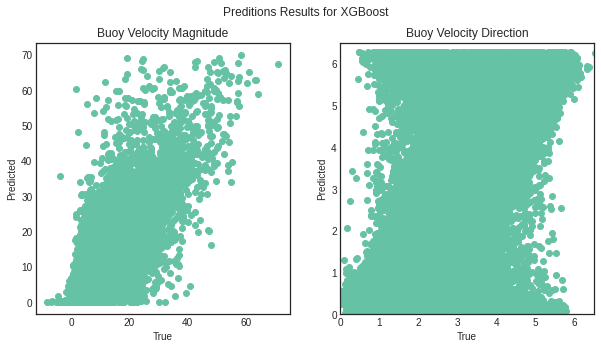

In [36]:
############
# XGBoost
############
rmse_mag = mean_squared_error(test_labels[0], XGBpredictions_mag)
rmse_dir = mean_squared_error(test_labels[1], XGBpredictions_dir)
fig, (ax1, ax2) = plt.subplots(1, 2)
fig.set_size_inches(10, 5)
fig.suptitle('Preditions Results for ' + 'XGBoost')

ax1.scatter(XGBpredictions_mag, test_labels[0])
ax1.set_ylabel("Predicted")
ax1.set_xlabel("True")
ax1.set_title('Buoy Velocity Magnitude')

ax2.scatter(XGBpredictions_dir, test_labels[1])
ax2.set_ylabel("Predicted")
ax2.set_xlabel("True")
ax2.set_title('Buoy Velocity Direction')

# ax1.set_xlim([0,20])
# ax1.set_ylim([0,20])
ax2.set_xlim([0,6.5])
ax2.set_ylim([0,6.5])

print("Overall RMSE for velocity magnitude: ", rmse_mag)
print("Overall RMSE for velocity direction: ", rmse_dir)

Overall RMSE:  9.300257181792498


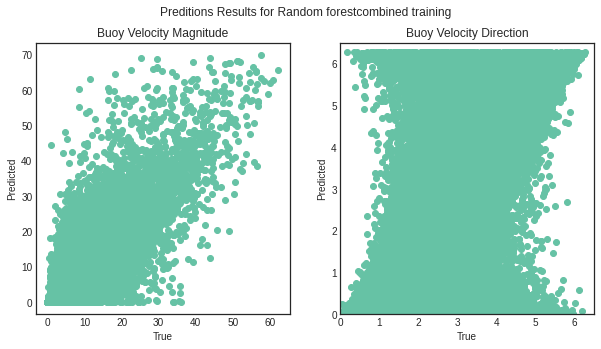

In [37]:
################
# random forest for two velocity components training at the same time
################
rmse_rf = mean_squared_error(test_labels, RFpredictions)
fig, (ax1, ax2) = plt.subplots(1, 2)
fig.set_size_inches(10, 5)
fig.suptitle('Preditions Results for ' + 'Random forest' + 'combined training')

ax1.scatter(RFpredictions[:,0], test_labels[0])
ax1.set_ylabel("Predicted")
ax1.set_xlabel("True")
ax1.set_title('Buoy Velocity Magnitude')

ax2.scatter(RFpredictions[:,1], test_labels[1])
ax2.set_ylabel("Predicted")
ax2.set_xlabel("True")
ax2.set_title('Buoy Velocity Direction')

# ax1.set_xlim([0,1])
# ax1.set_ylim([0,1])
ax2.set_xlim([0,6.5])
ax2.set_ylim([0,6.5])
print("Overall RMSE: ", rmse_rf)

Overall RMSE velocity direction:  75.77783390440173
Overall RMSE velocity magnitude:  17.247922838293974


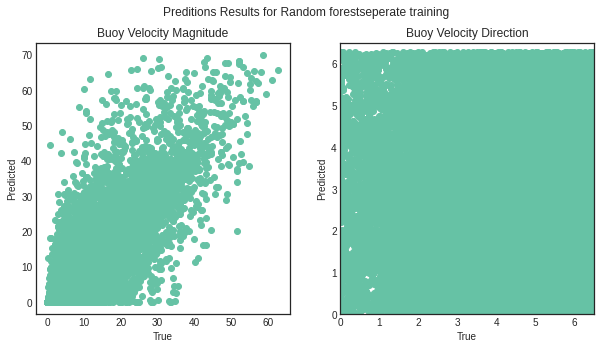

In [39]:
################
# random forest for two seperated components training
################
rmse_rf_dir = mean_squared_error(test_labels[1], RFpredictions_dir)
rmse_rf_mag = mean_squared_error(test_labels[0], RFpredictions_mag)
fig, (ax1, ax2) = plt.subplots(1, 2)
fig.set_size_inches(10, 5)
fig.suptitle('Preditions Results for ' + 'Random forest' + 'seperate training')

ax1.scatter(RFpredictions_mag, test_labels[0])
ax1.set_ylabel("Predicted")
ax1.set_xlabel("True")
ax1.set_title('Buoy Velocity Magnitude')

ax2.scatter(RFpredictions_dir, test_labels[1])
ax2.set_ylabel("Predicted")
ax2.set_xlabel("True")
ax2.set_title('Buoy Velocity Direction')

# ax1.set_xlim([0,1])
# ax1.set_ylim([0,1])
ax2.set_xlim([0,6.5])
ax2.set_ylim([0,6.5])
print("Overall RMSE velocity direction: ", rmse_rf_dir)
print("Overall RMSE velocity magnitude: ", rmse_rf_mag)

In [47]:
# print("Regression Score for random forest ", model.score(test_data, test_labels))
# print("Regression Score for Random forest velocity direction ", RF_dir.score(test_data, test_labels[1]))
# print("Regression Score for Random forest velocity magnitude ", RF_mag.score(test_data, test_labels[0]))
print("Regression Score for XGB velocity direction ", XGBModel_dir.score(test_data, test_labels[1]))
print("Regression Score for XGB velocity magnitude ", XGBModel_mag.score(test_data, test_labels[0]))

Regression Score for XGB velocity direction  0.5003075514450859
Regression Score for XGB velocity magnitude  0.6683276271203394


# save models

In [41]:
import pickle
# pickle.dump(model, open('models/random_forest.sav', 'wb'))  # this model is very large
pickle.dump(XGBModel_mag, open('models/XGBModel_mag.sav', 'wb'))
pickle.dump(XGBModel_dir, open('models/XGBModel_dir.sav', 'wb'))

# Run the model on test data

In [42]:
# Load the raw data to disk
input_path = "data/converted_test.csv"
df = pd.read_csv(input_path)

# Convert all column names to lower case and display the dataframe 
df = df.rename(str.lower, axis='columns')

# Remove any rows that have very low ice_thickness  
"""
sea ice concentration of 0.5 means that the surroundings of the buoy is 50% sea ice and 50% open water. So ice concentration of 
1 is full ice cover, while a concentration of 0.1 means there’S barely any ice left at that location!
"""
df = df[df["ice_thickness"] > 0.1]

from sklearn import preprocessing
df = df[['ice_thickness', 'wind_vel_mag', 'wind_vel_dir', 'd2c', 'buoy_lat', 'buoy_lon']]

test = df[['d2c', 'ice_thickness', 'wind_vel_mag', 'wind_vel_dir', 'buoy_lat', 'buoy_lon']]
x = test.values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
test = pd.DataFrame(x_scaled)
display(test)

,0,1,2,3,4,5
0,0.335219,0.403685,0.288794,0.086347,0.856604,0.651824
1,0.330633,0.404327,0.057738,0.522459,0.856207,0.652842
2,0.340424,0.604369,0.211366,0.399228,0.797337,0.091345
3,0.369097,0.397208,0.207510,0.148651,0.626102,0.163386
4,0.335655,0.402866,0.393638,0.426572,0.857030,0.652858
...,...,...,...,...,...,...
83923,0.481105,0.253252,0.186909,0.416933,0.713186,0.141115
83924,0.158325,0.163566,0.326542,0.554110,0.554316,0.276828
83925,0.018794,0.186973,0.174638,0.692854,0.541661,0.180336
83926,0.470990,0.220525,0.094702,0.593124,0.909470,0.457105


In [43]:
pred_XGB_mag = XGBModel_mag.predict(test)
pred_XGB_dir = XGBModel_dir.predict(test)

In [44]:
# convert magnitude and direction to components
import math
u = []
v = []
for i in range(len(pred_XGB_mag)):
    u.append(math.cos(pred_XGB_dir[i]) * pred_XGB_mag[i]) 
    v.append(math.sin(pred_XGB_dir[i]) * pred_XGB_mag[i])

In [45]:
df_pred = pd.DataFrame()
df_pred['u_buoy'] = u
df_pred['v_buoy'] = v

In [46]:
df_pred.to_csv("predictions_xgb.csv")